# 1. Pandemic Data Analysis

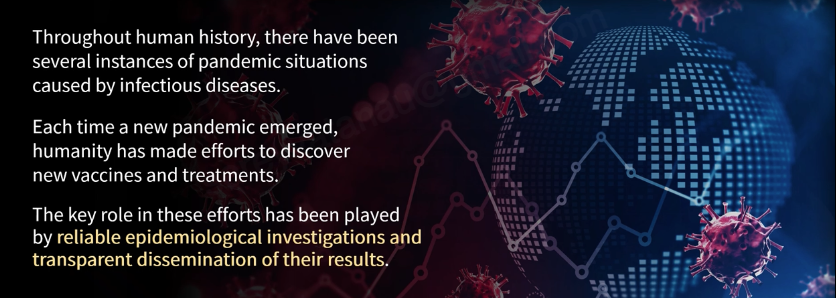

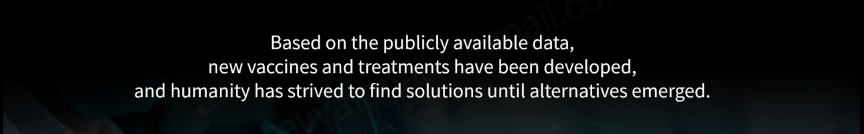

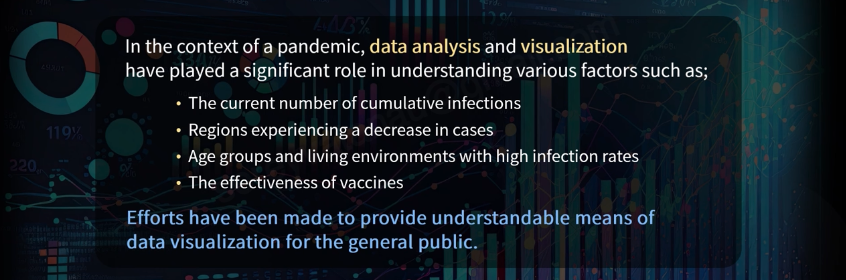

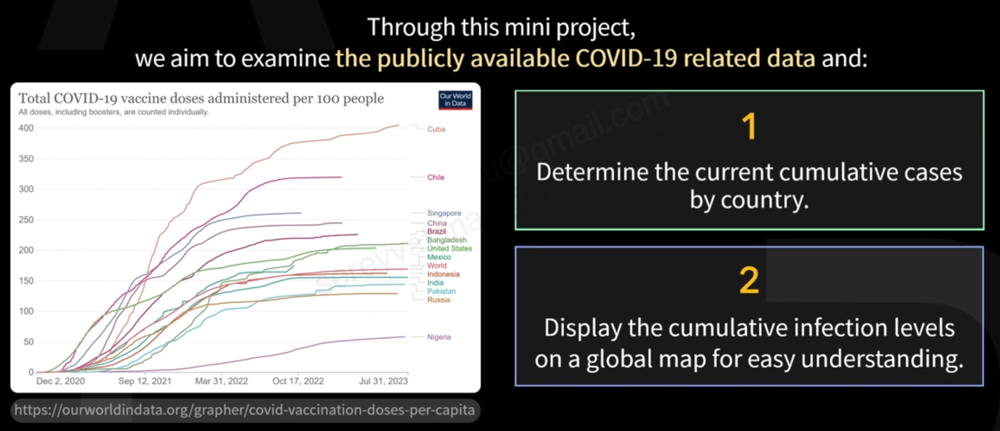

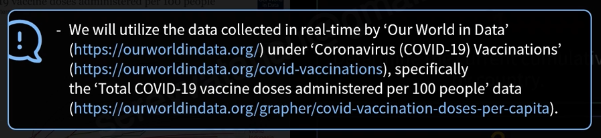

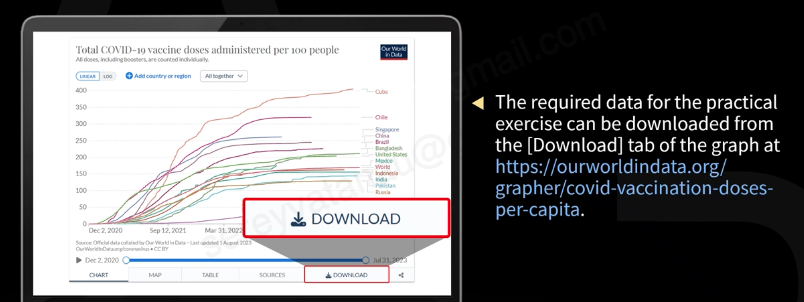

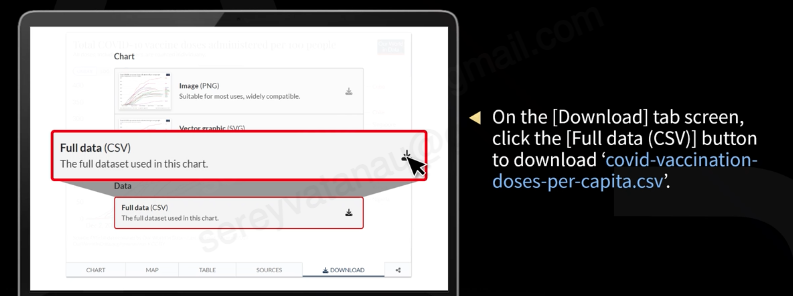

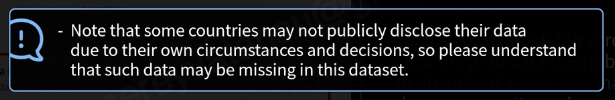

# 2. Pandemic Data Analysis Operation Process

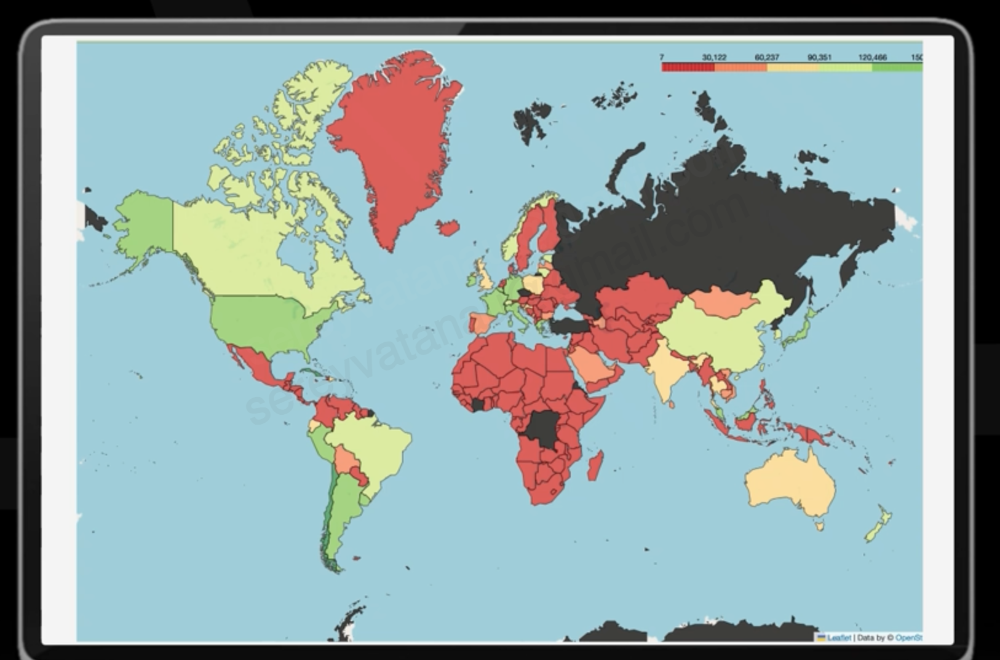

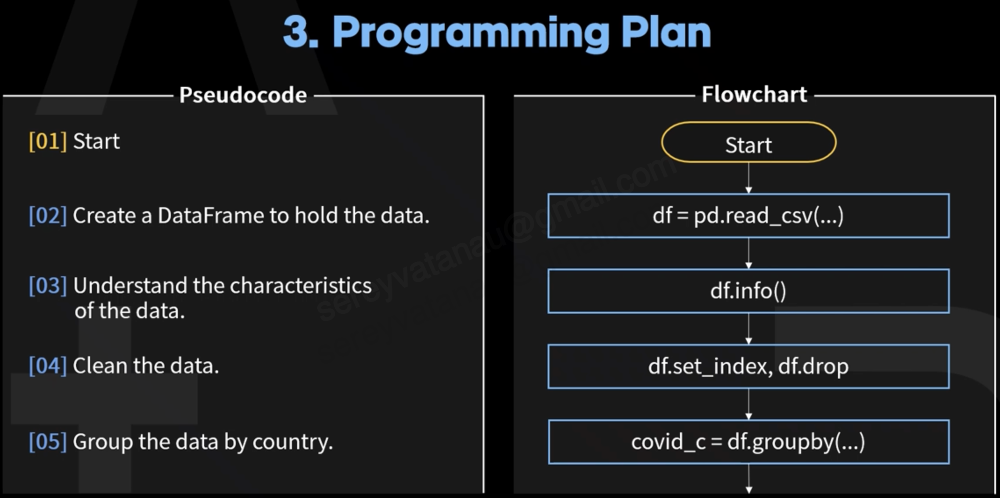

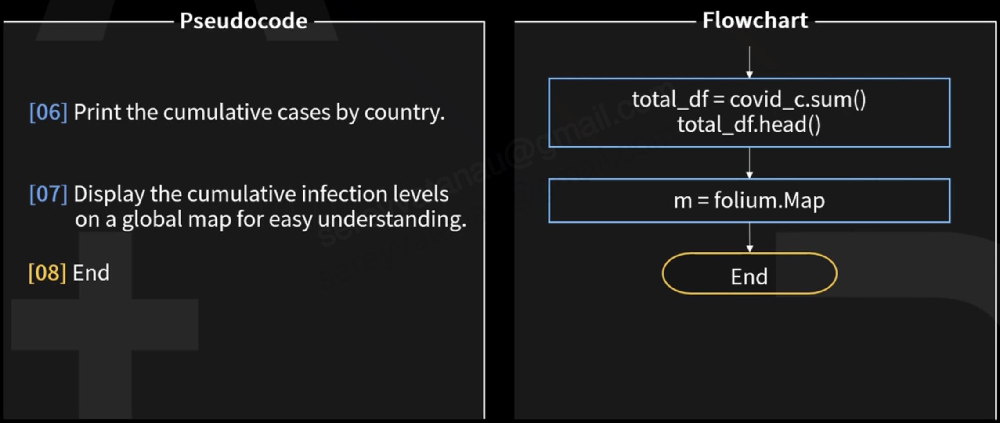

# Let's Code

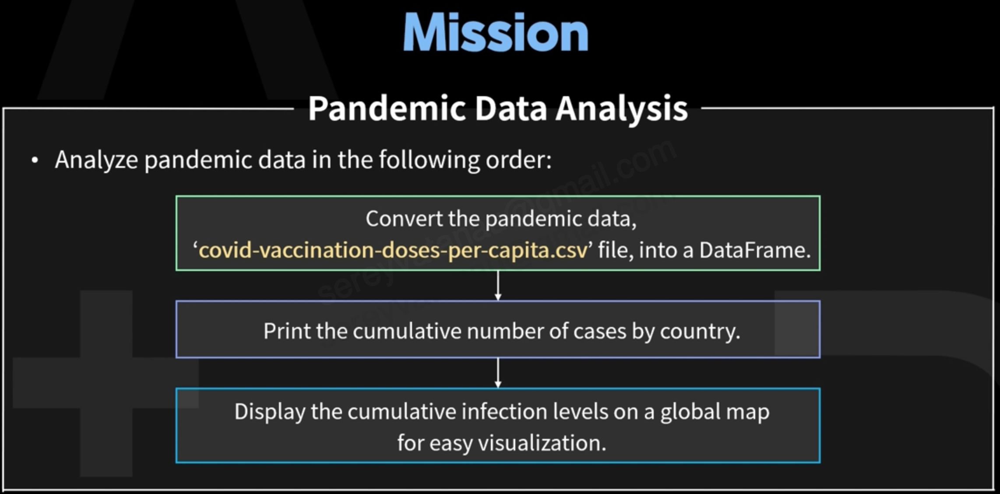

## Step1

- Enter the path of the downloaded file as a relative path.

In [7]:
import pandas as pd

df = pd.read_csv('./data/covid-vaccination-doses-per-capita.csv')
df.head()

,Entity,Code,Day,total_vaccinations_per_hundred
0,Afghanistan,AFG,2021-02-22,0.00
1,Afghanistan,AFG,2021-02-28,0.02
2,Afghanistan,AFG,2021-03-16,0.13
3,Afghanistan,AFG,2021-04-07,0.29
4,Afghanistan,AFG,2021-04-22,0.58


In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79662 entries, 0 to 79661
Data columns (total 4 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Entity                          79662 non-null  object 
 1   Code                            64649 non-null  object 
 2   Day                             79662 non-null  object 
 3   total_vaccinations_per_hundred  79662 non-null  float64
dtypes: float64(1), object(3)
memory usage: 2.4+ MB


- Check the technical summary of the data.

In [9]:
df['Date'] = pd.to_datetime(df['Day'])
df.set_index('Date', inplace = True)
df.drop(['Day'], axis = 1, inplace = True)

df.head()

,Entity,Code,total_vaccinations_per_hundred
Date,,,
2021-02-22,Afghanistan,AFG,0.00
2021-02-28,Afghanistan,AFG,0.02
2021-03-16,Afghanistan,AFG,0.13
2021-04-07,Afghanistan,AFG,0.29
2021-04-22,Afghanistan,AFG,0.58


- Line1: No operations are needed to convert the 'Day' column to a string type as it is already of the object data type.

- Only conversion to 'datetime' is required.

- Line2: Change the index to a new column.

- Line3: Remove unnecessary columns.

- Line5: Verify the DataFrame.

In [10]:
len(df['Entity'].unique())

236

- It can be observed that there are data from a total of 236 countries.

## Step2

- Since we will be storing cumulative data by country, create groups based on the 'Entity' column to generate a new DataFrame.

In [11]:
covid_c = df.groupby('Entity')

- By examining the result of the following code, it can be observed that the number of rows (length of the DataFrame) for each key, which represents the country name, varies.

In [12]:
for key, group in covid_c :
    print('+key', key)
    print('+number:', len(group))
    print(group.head())
    print('\n')

+key Afghanistan
+number: 141
                 Entity Code  total_vaccinations_per_hundred
Date                                                        
2021-02-22  Afghanistan  AFG                            0.00
2021-02-28  Afghanistan  AFG                            0.02
2021-03-16  Afghanistan  AFG                            0.13
2021-04-07  Afghanistan  AFG                            0.29
2021-04-22  Afghanistan  AFG                            0.58


+key Africa
+number: 982
            Entity Code  total_vaccinations_per_hundred
Date                                                   
2021-01-09  Africa  NaN                             0.0
2021-01-10  Africa  NaN                             0.0
2021-01-11  Africa  NaN                             0.0
2021-01-12  Africa  NaN                             0.0
2021-01-13  Africa  NaN                             0.0


+key Albania
+number: 280
             Entity Code  total_vaccinations_per_hundred
Date                                   

- This implies that the actual availability of data differs for each country.

- Remember that this represents one aspect of the real-world situation.

- Line1: Distinguish the information of the created groups based on the key.

- Save the group totals in a new DataFrame
    - This means statistical analysis of the cumulative number of cases per 100 inhabitants from the beginning of the COVID outbreak until the current moment for each country.

In [13]:
total_df = covid_c.sum(numeric_only = True)
total_df.head()

,total_vaccinations_per_hundred
Entity,
Afghanistan,3551.54
Africa,30647.20
Albania,13692.69
Algeria,664.55
Andorra,6928.74


## Step3

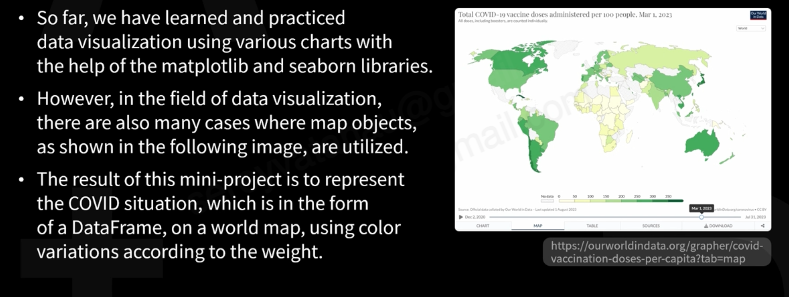

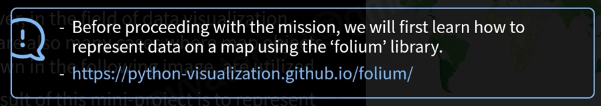

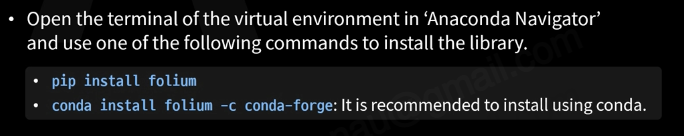

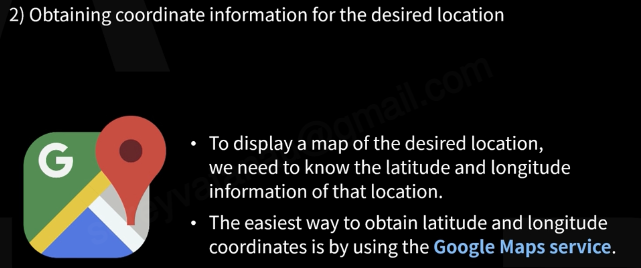

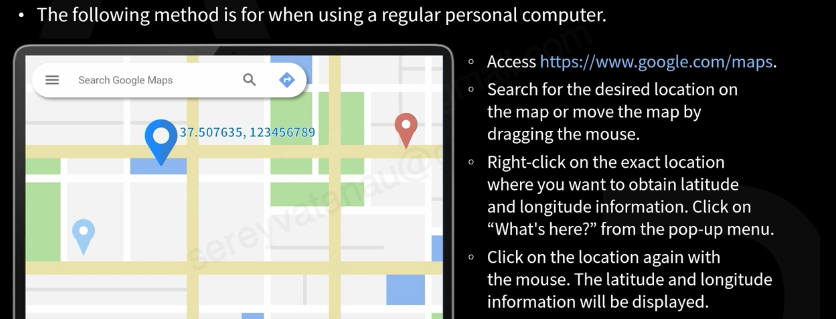

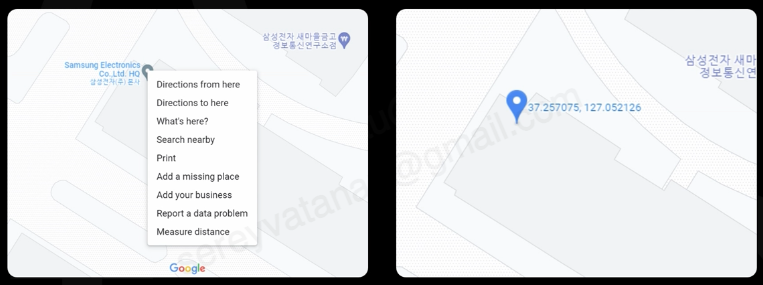

In [14]:
import folium 

map = folium.Map(location = [37.257068, 127.052136],
                zoom_start = 13,)

map

- Line3: Input the coordinates of the map's center, with latitude and longitude in order.

- Line4: Initial zoom level when rendering the map.

In [15]:
import folium 

map = folium.Map(location = [37.257068, 127.052136],
                zoom_start = 13,)

map.save('my_map.html')

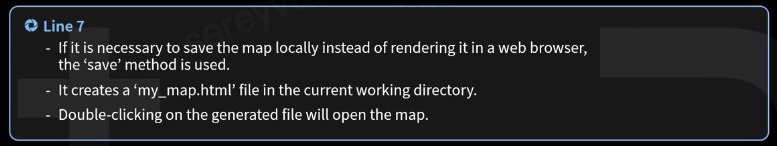

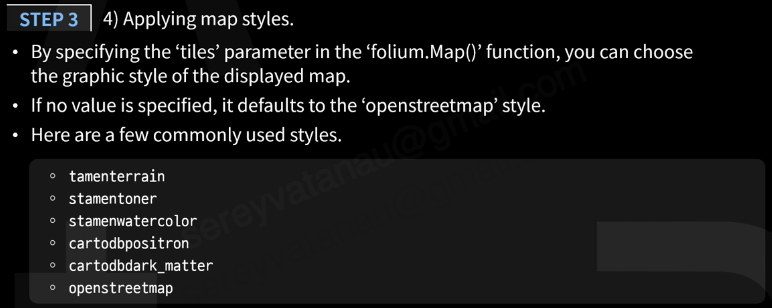

In [18]:
import folium 

map = folium.Map(location = [37.257068, 127.052136],
                zoom_start = 13,
                tiles = 'stamenwatercolor')

map

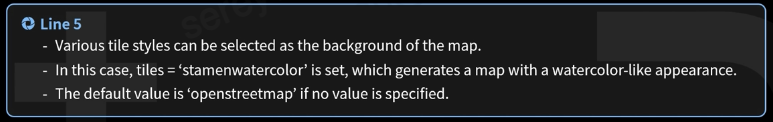

In [21]:
mark_map = folium.Map(location = [45.372, -121.6972], zoom_start = 12, tiles = 'stamen Terrain')

folium.Marker(location = [45.3288, -121.6625],
             popup = 'Mt. Hood Meadows',
             icon = folium.Icon(icon = 'cloud'),).add_to(mark_map)

folium.Marker(location = [45.3311, -121.7113],
             popup = 'Timberline Lodge',
             icon = folium.Icon(icon = 'green'),).add_to(mark_map)

folium.CircleMarker(location = [45.3800, -121.6000],
                   readius = 100,
                   popup = 'circle',
                   color = '#3186cc',
                   fill = True,
                   fill_color = '#3186cc').add_to(mark_map)

mark_map

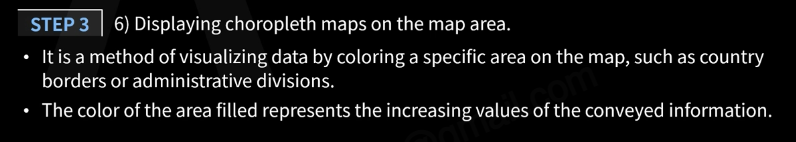

In [25]:
import pandas as pd
import folium

url = ('https://raw.githubusercontent.com/python-visualization/folium/master/examples/data')
state_geo = f"{url}/us-states.json"
state_unemployment = f"{url}/US_Unemployment_Oct2012.csv"
state_data = pd.read_csv(state_unemployment)

m = folium.Map(location = [48, -102], zoom_start = 3)

folium.Choropleth(geo_data = state_geo,
                 name = 'choropleth',
                 data = state_data,
                 columns = ['State', 'Unemployment'],
                 key_on = 'feature.id',
                 fill_color = 'YlGn',
                 fill_opacity = 0.7,
                 line_opacity = 0.2,
                 legend_name = 'Unemployment Rate (%)',).add_to(m)

folium.LayerControl().add_to(m)

m

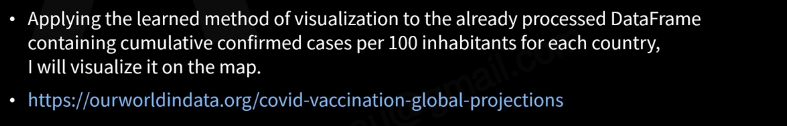

In [28]:
import folium
import json

center = [35.762887375145795, 84.08313219586536]

m = folium.Map(location = center, 
              zoom_start = 2,
              max_bounds = True,
              min_zoom = 1,
              min_lat = -84,
              max_lat = 84,
              min_lon = -175,
              max_lon = 187,)

geo_path = './data/World_Countries_Generalized.geojson'

json_data = json.load(open(geo_path, encoding = 'utf-8'))

folium.Choropleth(geo_data = json_data,
                 data = total_df,
                 columns = (total_df.index, 'total_vaccinations_per_hundred'),
                 key_on = 'properties.COUNTRY',
                 fill_color = 'RdYlGn',
                 fill_opacity = 0.7,
                 line_opacity = 0.5,
                 ).add_to(m)

folium.LayerControl().add_to(m)

In [33]:
m

# Finalized Code

In [32]:
import pandas as pd
import folium
import json

df = pd.read_csv('./data/covid-vaccination-doses-per-capita.csv')
print(df.head())

print('\n <Basic information for data>')
print(df.info())

print('\n <Data tidying>')
df['Date'] = pd.to_datetime(df['Day'])
df.set_index('Date', inplace = True)
df.drop(['Day'], axis = 1, inplace = True)
print(df.head())

print('\n <Accumulation by country>')
covid_c = df.groupby(['Entity'])
total_df = covid_c.sum(numeric_only = True)
print(total_df.head())

center = [35.762887375145795, 84.08313219586536]

m = folium.Map(location = center, 
              zoom_start = 2,
              max_bounds = True,
              min_zoom = 1,
              min_lat = -84,
              max_lat = 84,
              min_lon = -175,
              max_lon = 187,)

geo_path = './data/World_Countries_Generalized.geojson'

json_data = json.load(open(geo_path, encoding = 'utf-8'))

folium.Choropleth(geo_data = json_data,
                 data = total_df,
                 columns = (total_df.index, 'total_vaccinations_per_hundred'),
                 key_on = 'properties.COUNTRY',
                 fill_color = 'RdYlGn',
                 fill_opacity = 0.7,
                 line_opacity = 0.5,
                 ).add_to(m)

folium.LayerControl().add_to(m)
m

        Entity Code         Day  total_vaccinations_per_hundred
0  Afghanistan  AFG  2021-02-22                            0.00
1  Afghanistan  AFG  2021-02-28                            0.02
2  Afghanistan  AFG  2021-03-16                            0.13
3  Afghanistan  AFG  2021-04-07                            0.29
4  Afghanistan  AFG  2021-04-22                            0.58

 <Basic information for data>
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 79662 entries, 0 to 79661
Data columns (total 4 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Entity                          79662 non-null  object 
 1   Code                            64649 non-null  object 
 2   Day                             79662 non-null  object 
 3   total_vaccinations_per_hundred  79662 non-null  float64
dtypes: float64(1), object(3)
memory usage: 2.4+ MB
None

 <Data tidying>
                 Entity Code  total_v